# Nettoyage des données

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns


import string
import re
import spacy
import nltk
from nltk.corpus import stopwords
import random as rd

D:\Anaconda\envs\NLP\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
train = pd.read_csv('train.csv')

print(train.shape)
print(train.columns)

train.head()

(36765, 5)
Index(['discourse_id', 'essay_id', 'discourse_text', 'discourse_type',
       'discourse_effectiveness'],
      dtype='object')


,discourse_id,essay_id,discourse_text,discourse_type,discourse_effectiveness
0,0013cc385424,007ACE74B050,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate
1,9704a709b505,007ACE74B050,"On my perspective, I think that the face is a ...",Position,Adequate
2,c22adee811b6,007ACE74B050,I think that the face is a natural landform be...,Claim,Adequate
3,a10d361e54e4,007ACE74B050,"If life was on Mars, we would know by now. The...",Evidence,Adequate
4,db3e453ec4e2,007ACE74B050,People thought that the face was formed by ali...,Counterclaim,Adequate


In [3]:
train.nunique()

discourse_id               36765
essay_id                    4191
discourse_text             36691
discourse_type                 7
discourse_effectiveness        3
dtype: int64

In [4]:
types = set(train["discourse_type"].values)
print(types)

{'Claim', 'Evidence', 'Rebuttal', 'Position', 'Concluding Statement', 'Lead', 'Counterclaim'}


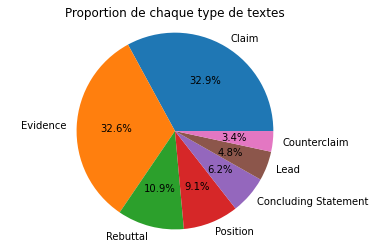

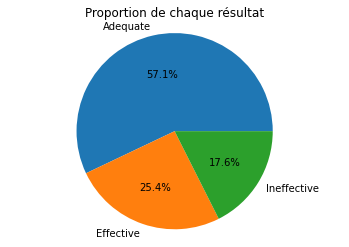

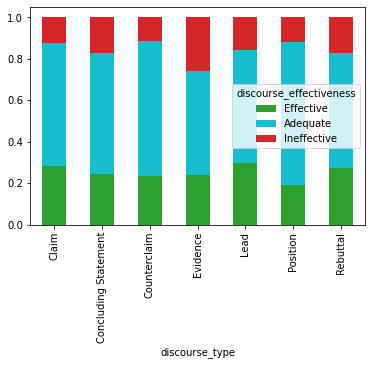

In [5]:
type_counts = train["discourse_type"].value_counts()
plt.pie(type_counts, labels=types, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.title("Proportion de chaque type de textes")
plt.show()

result_counts = train["discourse_effectiveness"].value_counts()
plt.pie(result_counts, labels=train["discourse_effectiveness"].value_counts().index, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.title("Proportion de chaque résultat")
plt.show()

counts = train.groupby(by='discourse_type')["discourse_effectiveness"].value_counts(normalize=True).unstack(fill_value=0)
counts[['Effective', 'Adequate', 'Ineffective']].plot.bar(stacked=True, color=['tab:green', 'tab:cyan', 'tab:red'])
plt.show()

In [6]:
def preprocessing_texts(text_data):
    #Fillna
    text_data = text_data.fillna("")
    #HTML tags
    text_data = text_data.apply(lambda x: re.sub(r'\<[^\>]*\>', ' ', x))
    #Digits
    text_data = text_data.apply(lambda x: re.sub(r'\d+', '', x))
    #whitespace
    text_data = text_data.apply(lambda x: re.sub(rf"[{re.escape(string.whitespace)}]+", ' ', x))
    return text_data

data = train[['discourse_text', 'discourse_type', 'discourse_effectiveness']]
data['clean_text'] = preprocessing_texts(data['discourse_text'])
data.head()

C:\Users\monte\AppData\Local\Temp\ipykernel_14360\259630765.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['clean_text'] = preprocessing_texts(data['discourse_text'])


,discourse_text,discourse_type,discourse_effectiveness,clean_text
0,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate,"Hi, i'm Isaac, i'm going to be writing about h..."
1,"On my perspective, I think that the face is a ...",Position,Adequate,"On my perspective, I think that the face is a ..."
2,I think that the face is a natural landform be...,Claim,Adequate,I think that the face is a natural landform be...
3,"If life was on Mars, we would know by now. The...",Evidence,Adequate,"If life was on Mars, we would know by now. The..."
4,People thought that the face was formed by ali...,Counterclaim,Adequate,People thought that the face was formed by ali...


In [7]:
#import nltk
#nltk.download('omw-1.4')
from nltk.stem import WordNetLemmatizer

def prepare_texts(text_data):
    #punctuation
    punctuations = '.,!?:;-=..."@#_()' + "'"
    text_data = text_data.apply(lambda x: re.sub(rf'[{punctuations}]', ' ', x))
    #lowercase
    text_data = text_data.apply(lambda x: x.lower())
    #stopwords
    stop = set(stopwords.words('english'))
    #lemmatization
    lemmatizer = WordNetLemmatizer()
    text_data = text_data.apply(lambda x: " ".join([lemmatizer.lemmatize(word) for word in x.split(" ") if lemmatizer.lemmatize(word) not in stop]))
    #whitespaces again
    text_data = text_data.apply(lambda x: re.sub(rf"[{re.escape(string.whitespace)}]+", ' ', x))
    return text_data
                    
data['cleaner_text'] = prepare_texts(data["clean_text"])
data.head()

,discourse_text,discourse_type,discourse_effectiveness,clean_text,cleaner_text
0,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate,"Hi, i'm Isaac, i'm going to be writing about h...",hi isaac going writing face mar natural landfo...
1,"On my perspective, I think that the face is a ...",Position,Adequate,"On my perspective, I think that the face is a ...",perspective think face natural landform dont t...
2,I think that the face is a natural landform be...,Claim,Adequate,I think that the face is a natural landform be...,think face natural landform life mar descovere...
3,"If life was on Mars, we would know by now. The...",Evidence,Adequate,"If life was on Mars, we would know by now. The...",life wa mar would know reason think natural la...
4,People thought that the face was formed by ali...,Counterclaim,Adequate,People thought that the face was formed by ali...,people thought face wa formed alieans thought ...


In [8]:
def frequency_barplot(df, nr_top_words=50):
    fig, ax = plt.subplots(1,1,figsize=(20,5))
    
    #Notons que la fonction trie le dataframe !
    df.sort_values(ascending=False, inplace = True)
    sns.barplot(list(range(nr_top_words)), df.values[:nr_top_words], palette='hls', ax=ax)

    ax.set_xticks(list(range(nr_top_words)))
    ax.set_xticklabels(df.index[:nr_top_words], fontsize=14, rotation=90)
    return ax

def top_words(text_data, normalize=False):
    
    #enlève juste les ponctuations ??? FLAG
    pattern = (
        rf"((\w)[{string.punctuation}](?:\B|$)|(?:^|\B)[{string.punctuation}](\w))"
    )

    return (
        text_data.apply(lambda x: x.replace(pattern, r"\2 \3").split()).explode().value_counts(normalize=normalize)
    )

D:\Anaconda\envs\NLP\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
D:\Anaconda\envs\NLP\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


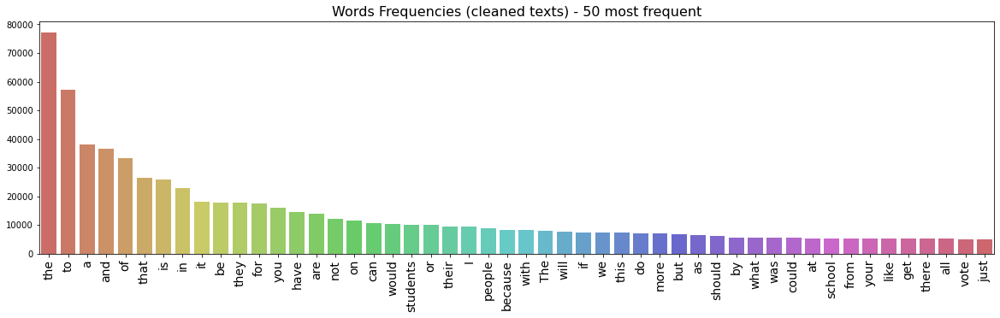

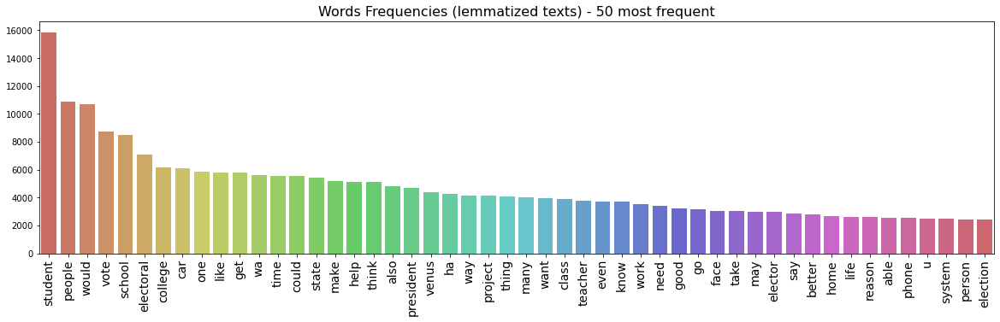

In [9]:
n_mots = 50

words_org = top_words(data['clean_text']).head(n_mots)
words_cln = top_words(data['cleaner_text']).head(n_mots)

ax = frequency_barplot(words_org)
ax.set_title("Words Frequencies (cleaned texts) - 50 most frequent", fontsize=16);
ax = frequency_barplot(words_cln)
ax.set_title("Words Frequencies (lemmatized texts) - 50 most frequent", fontsize=16);

In [10]:
from collections import Counter
from wordcloud import WordCloud

def draw_wordcloud(text_data, width = 800, height: int = 400, max_words=200, min_font_size=4,
              relative_scaling="auto", colormap='viridis', figsize=(20,10)):

    words = top_words(text_data)

    wordcloud = WordCloud(
        width=width,
        height=height,
        max_words=max_words,
        min_font_size=min_font_size,
        background_color="WHITE",
        max_font_size=None,
        relative_scaling=relative_scaling,
        colormap=colormap,
    ).generate_from_frequencies(words)

    fig, ax = plt.subplots(figsize=figsize)
    ax.imshow(wordcloud, interpolation="bilinear")
    ax.axis("off")

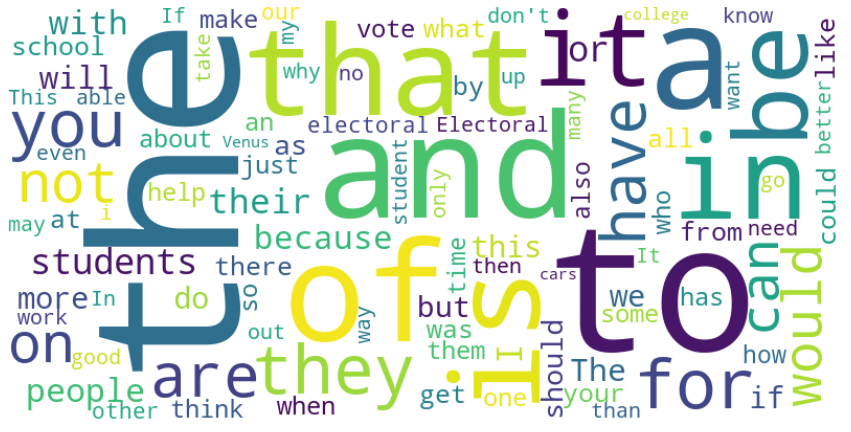

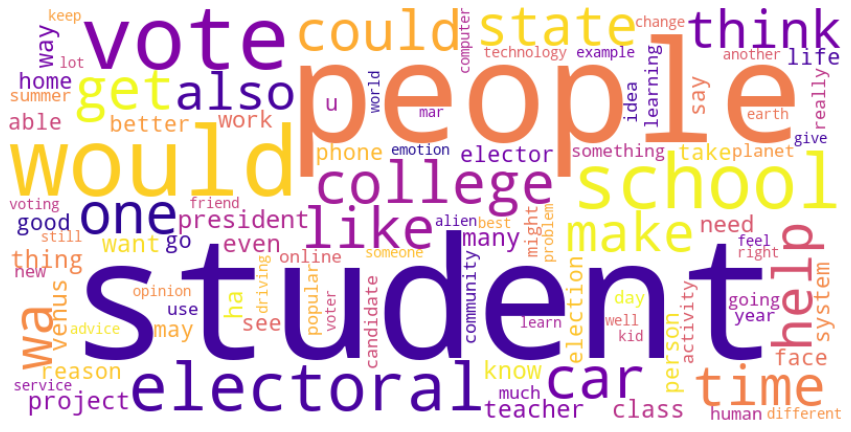

In [11]:
draw_wordcloud(data['clean_text'], max_words=100, colormap='viridis', width=800, height=400, figsize=(15,8))
draw_wordcloud(data['cleaner_text'], max_words=100, colormap='plasma', width=800, height=400, figsize=(15,8))

# Vectorisations

## TF-IDF

In [12]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.manifold import TSNE

def scatterplot(data, col, color = None, hover_name = None, hover_data = None, title = ""):
    plot_values = np.stack(data[col], axis=1)
    dimension = len(plot_values)

    if dimension < 2 or dimension > 3:
        print("The column you want to visualize has dimension < 2 or dimension > 3.")
        print(" The function can only visualize 2- and 3-dimensional data.")

    else:
        if dimension == 2:
            x, y = plot_values[0], plot_values[1]

            fig = px.scatter(
                data,
                x=x,
                y=y,
                color=color,
                hover_data=hover_data,
                title=title,
                hover_name=hover_name,
            )

        else:
            x, y, z = plot_values[0], plot_values[1], plot_values[2]

            fig = px.scatter_3d(
                data,
                x=x,
                y=y,
                z=z,
                color=color,
                hover_data=hover_data,
                title=title,
                hover_name=hover_name,
            )

        fig.show()


def tokenize(text_data):
    punct = string.punctuation.replace("_", "")
    # In regex, the metacharacter 'w' is "a-z, A-Z, 0-9, including the _ (underscore)
    # character." We therefore remove it from the punctuation string as this is already
    # included in \w.

    pattern = rf"((\w)([{punct}])(?:\B|$)|(?:^|\B)([{punct}])(\w))"

    return text_data.apply(lambda x: x.replace(pattern, r"\2 \3 \4 \5").split())

def tfidf(text_data, max_features=None, min_df=1, max_df=1.0):

    # Check if input is tokenized. Else, print warning and tokenize.
    if not isinstance(text_data.iloc[0], list):
        text_data = tokenize(text_data)

    tfidf = TfidfVectorizer(
        use_idf=True,
        max_features=max_features,
        min_df=min_df,
        max_df=max_df,
        tokenizer=lambda x: x,
        preprocessor=lambda x: x,
        norm=None,  # Disable l1/l2 normalization.
    )

    tfidf_vectors_csr = tfidf.fit_transform(text_data)
    features = tfidf.get_feature_names()
    
    return pd.DataFrame.sparse.from_spmatrix(tfidf_vectors_csr, text_data.index, features)
    



def tsne(
    input_matrix,
    n_components=2,
    perplexity=30.0,
    learning_rate=200.0,
    n_iter=1000,
    random_state=None,
    n_jobs=-1,
):
    
    # Default n_components=2 to enable users to easily plot the results.
    tsne = TSNE(
        n_components=n_components,
        perplexity=perplexity,
        learning_rate=learning_rate,
        n_iter=n_iter,
        random_state=random_state,
        n_jobs=n_jobs,
    )

    if isinstance(input_matrix, pd.DataFrame):
        input_matrix_coo = input_matrix.sparse.to_coo()
        input_matrix_for_vectorization = input_matrix_coo.astype("float64")
    else:
        input_matrix_for_vectorization = list(input_matrix)

    return pd.Series(
        list(tsne.fit_transform(input_matrix_for_vectorization)),
        index=input_matrix.index,
    )


In [13]:
#FLAG fait le tf-idf
tf_idf = tfidf(data['cleaner_text'], max_features=1000)
tf_idf.head()

D:\Anaconda\envs\NLP\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,%,-,-d,ability,able,abolish,academic,access,accident,according,...,worthy,would,wouldnt,write,writing,wrong,year,yes,yet,young
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,6.456083,0.0,0.0,0.0,0.000000,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,5.719315,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2.663389,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0


In [14]:
data['TF-IDF'] = tf_idf.sparse.to_dense().apply(lambda x: x.tolist(), axis=1)
data.head()

,discourse_text,discourse_type,discourse_effectiveness,clean_text,cleaner_text,TF-IDF
0,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate,"Hi, i'm Isaac, i'm going to be writing about h...",hi isaac going writing face mar natural landfo...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,"On my perspective, I think that the face is a ...",Position,Adequate,"On my perspective, I think that the face is a ...",perspective think face natural landform dont t...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,I think that the face is a natural landform be...,Claim,Adequate,I think that the face is a natural landform be...,think face natural landform life mar descovere...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,"If life was on Mars, we would know by now. The...",Evidence,Adequate,"If life was on Mars, we would know by now. The...",life wa mar would know reason think natural la...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,People thought that the face was formed by ali...,Counterclaim,Adequate,People thought that the face was formed by ali...,people thought face wa formed alieans thought ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [15]:
#On fait un t-SNE avec Texthero
data['t-SNE (TF-IDF)'] = tsne(data['TF-IDF'])

D:\Anaconda\envs\NLP\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


In [16]:
scatterplot(data, col='t-SNE (TF-IDF)', title="t-SNE (TF-IDF)", color='discourse_type')

In [17]:
scatterplot(data, col='t-SNE (TF-IDF)', title="t-SNE (TF-IDF)", color='discourse_effectiveness')

## USE

In [18]:
import tensorflow
import tensorflow_hub as hub

#On importe le modèle pré-entraîné
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [19]:
#On précise quelle colonne contient les textes à manipuler
data['USE'] = data['clean_text'].apply(lambda x: embed([x]).numpy()[0])
#On vérifie que tout s'est bien passé
data.head()

,discourse_text,discourse_type,discourse_effectiveness,clean_text,cleaner_text,TF-IDF,t-SNE (TF-IDF),USE
0,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate,"Hi, i'm Isaac, i'm going to be writing about h...",hi isaac going writing face mar natural landfo...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[47.505493, 27.312841]","[-0.050906982, -0.051439855, 0.025082737, 0.04..."
1,"On my perspective, I think that the face is a ...",Position,Adequate,"On my perspective, I think that the face is a ...",perspective think face natural landform dont t...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[50.16205, 28.198246]","[-0.0029081788, -0.01958676, 0.018444575, -0.0..."
2,I think that the face is a natural landform be...,Claim,Adequate,I think that the face is a natural landform be...,think face natural landform life mar descovere...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[49.586586, 28.49206]","[-0.017455006, -0.057197697, 0.007328533, 0.05..."
3,"If life was on Mars, we would know by now. The...",Evidence,Adequate,"If life was on Mars, we would know by now. The...",life wa mar would know reason think natural la...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[49.862255, 26.95896]","[-0.03046168, -0.06301315, 0.013621683, 0.0557..."
4,People thought that the face was formed by ali...,Counterclaim,Adequate,People thought that the face was formed by ali...,people thought face wa formed alieans thought ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[36.371967, 16.106764]","[-0.020772688, -0.048708, -0.0008243022, -0.01..."


In [20]:
data['t-SNE (USE)'] = tsne(data['USE'])

D:\Anaconda\envs\NLP\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.



In [21]:
scatterplot(data, col='t-SNE (USE)', title="t-SNE (USE)", color='discourse_type')

In [22]:
scatterplot(data, col='t-SNE (USE)', title="t-SNE (USE)", color='discourse_effectiveness')

## BERT

In [23]:
from transformers import BertTokenizer, BertModel

#Fonction qui va séparer le document en phrases, avant d'ajouter les indicateurs spécifiques à BERT
def decoupage_phrases_BERT(texte):
    phrases = re.findall(r'[^\.\!\?]*[\.\!\?]', texte)
    return ["[CLS] " + sentence + " [SEP]" for sentence in phrases]

#Fonction qui va tokenizer une phrase (avec un BERT tokenizer, qui va découper certains mots), avant de convertir
#les tokens en nombres reconnus par BERT. On pense à tronquer la phrase si elle est trop longue
def preparation_phrase(phrase, tokenizer, MAX_LEN=512):
    temp = tokenizer.tokenize(phrase)
    ids = [tokenizer.convert_tokens_to_ids(token) for token in temp]
    if len(ids) > 512:
        ids = ids[:512]
    return ids

In [24]:
import torch

#Fonction qui va vectoriser avec BERT une phrase préalablement formatée
def vectorisation_BERT(input_ids, model):
    #On formate les ids reconnus par BERT en un tensor de torch
    tokens_tensor = torch.tensor([input_ids])
    #On génère un masque d'attention, ici ==1 car on n'entre qu'une phrase à la fois
    segments_tensors = torch.tensor([[1] * len(input_ids)])
    #On vient récupérer le résultat
    with torch.no_grad():
        outputs = model(tokens_tensor, segments_tensors)
        #Il faudra paramètrer le modèle avec `output_hidden_states = True`,
        #afin de pouvoir récupérer les états cachés des couches de neurones
        hidden_states = outputs[2]
        # `hidden_states` has shape [13 x 1 x 22 x 768]
    #On va prendre comme vectorisation de la phrase la moyenne des 22 vecteurs de taille 768
    sentence_embedding = torch.mean(hidden_states[-2][0], dim=0)
    #On n'oublie pas de convertir le résultat en array de numpy
    return sentence_embedding.numpy()

#Fonction qui va faire appel aux 3 fonctions précédentes pour transformer un texte en un vecteur de taille 768
def vectorisation_texte(texte, model, tokenizer):
    #On segmente le texte en phrases
    phrases = decoupage_phrases_BERT(texte)
    #On liste les vectorisations de chacune des phrases du texte, après tokenization et formatage
    vecteurs = [vectorisation_BERT(preparation_phrase(phrase, tokenizer), model) for phrase in phrases]
    #On renvoie la moyenne des vectorisations des phrases contenues dans notre texte
    return np.mean(vecteurs, axis=0)

In [25]:
#On prépare le tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-cased', do_lower_case=True)
#On prépare le modèle pré-entrainé ("from_pretrained"), en précisant "output_hidden_states = True"
model = BertModel.from_pretrained('bert-base-cased', output_hidden_states = True)
#Put the model in "evaluation" mode, meaning feed-forward operation.
model.eval()

Some weights of the model checkpoint at bert-base-cased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


BertModel(
  (embeddings): BertEmbeddings(
    (word_embeddings): Embedding(28996, 768, padding_idx=0)
    (position_embeddings): Embedding(512, 768)
    (token_type_embeddings): Embedding(2, 768)
    (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): BertEncoder(
    (layer): ModuleList(
      (0): BertLayer(
        (attention): BertAttention(
          (self): BertSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): BertSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inplace=False)
          

In [26]:
data['BERT'] = data['clean_text'].apply(lambda x: vectorisation_texte(x, model, tokenizer))

D:\Anaconda\envs\NLP\lib\site-packages\numpy\core\fromnumeric.py:3474: RuntimeWarning:

Mean of empty slice.



In [27]:
data.head()

,discourse_text,discourse_type,discourse_effectiveness,clean_text,cleaner_text,TF-IDF,t-SNE (TF-IDF),USE,t-SNE (USE),BERT
0,"Hi, i'm Isaac, i'm going to be writing about h...",Lead,Adequate,"Hi, i'm Isaac, i'm going to be writing about h...",hi isaac going writing face mar natural landfo...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[47.505493, 27.312841]","[-0.050906982, -0.051439855, 0.025082737, 0.04...","[-23.996597, -43.74955]","[0.1717989, -0.33110753, -0.04913491, -0.16824..."
1,"On my perspective, I think that the face is a ...",Position,Adequate,"On my perspective, I think that the face is a ...",perspective think face natural landform dont t...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[50.16205, 28.198246]","[-0.0029081788, -0.01958676, 0.018444575, -0.0...","[-23.915686, -46.04657]","[0.45675257, -0.26694158, -0.04001617, -0.3009..."
2,I think that the face is a natural landform be...,Claim,Adequate,I think that the face is a natural landform be...,think face natural landform life mar descovere...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[49.586586, 28.49206]","[-0.017455006, -0.057197697, 0.007328533, 0.05...","[-23.48688, -45.820652]",NaN
3,"If life was on Mars, we would know by now. The...",Evidence,Adequate,"If life was on Mars, we would know by now. The...",life wa mar would know reason think natural la...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[49.862255, 26.95896]","[-0.03046168, -0.06301315, 0.013621683, 0.0557...","[-24.412708, -45.782314]","[0.32317403, -0.09036433, -0.18716869, -0.2106..."
4,People thought that the face was formed by ali...,Counterclaim,Adequate,People thought that the face was formed by ali...,people thought face wa formed alieans thought ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[36.371967, 16.106764]","[-0.020772688, -0.048708, -0.0008243022, -0.01...","[-20.838531, -42.53111]","[0.0710082, -0.3888065, -0.06524733, -0.448907..."


In [28]:
data_bert = data.dropna(subset = ['BERT'])

In [29]:
data_bert['t-SNE (BERT)'] = tsne(data_bert['BERT'])

D:\Anaconda\envs\NLP\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

C:\Users\monte\AppData\Local\Temp\ipykernel_14360\1911904867.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [30]:
scatterplot(data_bert, col='t-SNE (BERT)', title="t-SNE (BERT)", color='discourse_type')

In [31]:
scatterplot(data_bert, col='t-SNE (BERT)', title="t-SNE (BERT)", color='discourse_effectiveness')

In [32]:
data_bert = data.dropna(subset = ['BERT'])

In [33]:
print(data['BERT'].apply(np.array).mean())

[ 1.83172256e-01 -6.25582412e-02 -7.17498362e-03 -1.42302439e-01
  1.81353480e-01 -5.68482317e-02  1.94223002e-01  1.22421294e-01
 -1.59542322e-01 -8.57417658e-02  1.41620785e-01  2.13596761e-01
  1.90511003e-01 -2.48681698e-02 -1.57581031e-01 -1.65365890e-01
  8.14074203e-02 -3.10359546e-03 -2.64852613e-01  3.05746160e-02
 -6.56522810e-02 -6.47463128e-02 -8.61044079e-02 -2.62439191e-01
 -1.90248445e-01 -3.27604890e-01 -6.68993220e-02  3.12124342e-01
  1.28113151e-01  2.96602190e-01 -8.79700184e-02 -1.40187126e-02
  3.99651453e-02  1.04001082e-01 -9.60025713e-02  7.02706575e-02
  1.44771367e-01  1.76849589e-01 -5.00637405e-02 -1.38765737e-01
  4.39792871e-01  7.05062672e-02 -1.51337221e-01  3.65681857e-01
  3.01763445e-01  5.56110330e-02  2.19103441e-01  1.19092658e-01
 -9.64646786e-02 -9.19136703e-02  4.59266484e-01 -8.81078020e-02
 -2.92557687e-01 -2.39431813e-01 -2.94978768e-02  3.78483790e-03
 -2.43530408e-01 -1.07363425e-01 -2.67954141e-01  4.62547362e-01
  1.49683177e-01  1.91314

In [34]:
def fill_nan(x, value):
    if x == "NaN":
        return value
    else:
        return x

# Classifieurs

In [35]:
from sklearn import metrics

def indic_performances(modele, X_train, y_train, X_test, y_test):
    y_simul = modele.predict_proba(X_train)
    y_pred = modele.predict_proba(X_test)    
    logloss_train = metrics.log_loss(y_train, y_simul)
    logloss_test = metrics.log_loss(y_test, y_pred)
    return (logloss_train, logloss_test)

In [36]:
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import LinearSVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
import timeit



def default_try_classifier(classif, X_train, y_train, X_test, y_test):
    #On retient le temps de démarrage du calcul, avant de calquer le modèle sur le jeu de train
    start_time = timeit.default_timer()
    classif.fit(X_train, y_train)
    #On récupère le temps de calcul, ainsi que les prédictions sur les deux jeux pour évaluer les performances
    elapsed = timeit.default_timer() - start_time
    #On récupère les indicateurs de performances de ce modèle
    scores = indic_performances(classif, X_train, y_train, X_test, y_test)
    return (scores, elapsed)



#On va lister les fonctions implémentées dans un dictionnaire
dict_classifiers = {#'Linear Support Vector Classification' : (LinearSVC, {'random_state':42}), 
                    'Logistic Regression classifier' : (LogisticRegression, {'random_state':42, 'n_jobs':-1}),
                    'Random Forest classifier' : (RandomForestClassifier, {'random_state':42, 'n_jobs':-1}),
                    'Multi-layer Perceptron' : (MLPClassifier, {'random_state':42, 'early_stopping':True}),
                    'XGBoost Classifier' : (XGBClassifier, {'objective':'multi:softproba', 'eval_metric':'merror',
                                                            'num_class':3, 'seed':42, 'n_jobs':-1})}

In [39]:
dict_vector = {'TF-IDF' : data['TF-IDF'],
               'USE' : data['USE'],
               'BERT' : data_bert['BERT']}

In [40]:
#import random as rd

#rd.seed(0)
#proportion_test = 0.2
#test_index = rd.sample(data.index.tolist(), int(data.shape[0]*proportion_test))


from sklearn.model_selection import train_test_split

list_vector = ['TF-IDF', 'USE', 'BERT']
data_train, data_test = train_test_split(data, stratify=data['discourse_type'], test_size=.2, random_state=42)

(29412, 10)
(7353, 10)


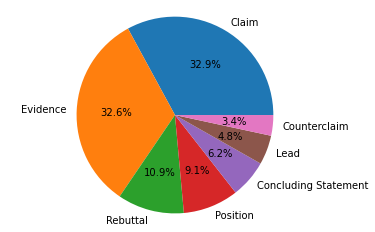

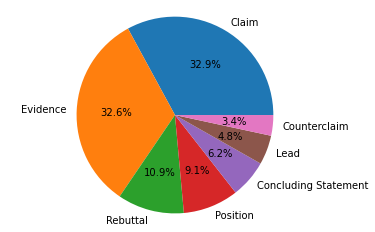

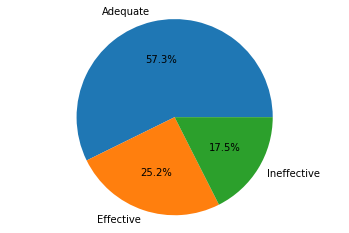

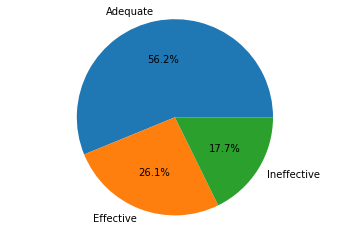

In [43]:
print(data_train.shape)
print(data_test.shape)


counts_train = data_train["discourse_type"].value_counts()
plt.pie(counts_train, labels=types, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.show()
counts_test = data_test["discourse_type"].value_counts()
plt.pie(counts_train, labels=types, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.show()

counts_train = data_train["discourse_effectiveness"].value_counts()
plt.pie(counts_train, labels=data_train["discourse_effectiveness"].value_counts().index, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.show()
counts_test = data_test["discourse_effectiveness"].value_counts()
plt.pie(counts_test, labels=data_test["discourse_effectiveness"].value_counts().index, autopct='%1.1f%%', radius=2)
plt.axis('equal')
plt.show()

In [44]:
from sklearn.preprocessing import LabelEncoder

performances = pd.DataFrame(index = ['train log loss', 'test log loss', 'computation time'])




print(f"Baseline : TF-IDF & Naive Bayes : \n")
#On prépare les données à classifier, pour le train et le test
X_train = pd.DataFrame(data_train['TF-IDF'].tolist())
X_test = pd.DataFrame(data_test['TF-IDF'].tolist())

LE = LabelEncoder()
y_train = LE.fit_transform(data_train['discourse_effectiveness'])
y_test = LE.transform(data_test['discourse_effectiveness'])

    
classif = MultinomialNB()
results = default_try_classifier(classif, X_train, y_train, X_test, y_test)

performances['Baseline'] = [results[0][0], results[0][1], results[1]]



Baseline : TF-IDF & Naive Bayes : 



In [59]:
print(performances)

                  Baseline
train log loss    5.685889
test log loss     5.624772
computation time  0.213362


In [60]:
def compare_classifiers(data_train, data_test, col_y, list_vector, dict_classifiers):
    
    perform = pd.DataFrame(index = ['train log loss', 'test log loss', 'computation time'])
    
    for vect in list_vector:
        
        X_train =  pd.DataFrame(data_train[vect].dropna().tolist())
        X_test = pd.DataFrame(data_test[vect].dropna().tolist())
        #X_test = pd.DataFrame(data[item_v].loc[test_index].dropna().tolist())
        
        LE = LabelEncoder()
        y_train = LE.fit_transform(data_train[col_y].iloc[X_train.index])
        y_test = LE.transform(data_test[col_y].iloc[X_test.index])
        #y_test = LE.fit_transform(data[col_y].iloc[X_test.index])
    
    
        for key_c, item_c in dict_classifiers.items():
            classif = item_c[0](**item_c[1])
            results = default_try_classifier(classif, X_train, y_train, X_test, y_test)
            
            perform[vect + ' + ' + key_c] = [results[0][0], results[0][1], results[1]]
        
    return perform

def plot_performances(perform):
    perform.transpose().plot(kind='bar',secondary_y='computation time')
    plt.show()

In [61]:
dict_classifiers = {'Logistic Regression classifier' : (LogisticRegression, {'random_state':42, 'n_jobs':-1}),
                    'Random Forest classifier' : (RandomForestClassifier, {'random_state':42, 'n_jobs':-1}),
                    'Multi-layer Perceptron' : (MLPClassifier, {'random_state':42, 'early_stopping':True}),
                    'XGBoost Classifier' : (XGBClassifier, {'objective':'multi:softproba', 'eval_metric':'merror',
                                                            'num_class':3, 'seed':42, 'n_jobs':-1})}

list_vector = ['TF-IDF', 'USE', 'BERT']
discourse_types = types

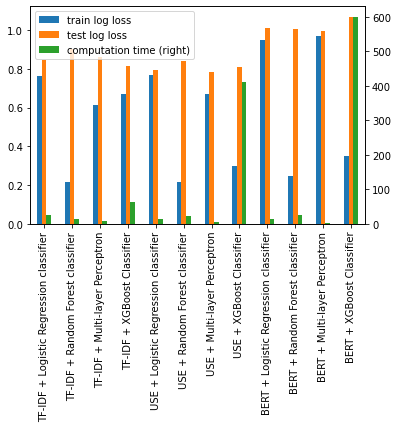

In [62]:
perform = compare_classifiers(data_train, data_test, 'discourse_effectiveness', list_vector, dict_classifiers)
plot_performances(perform)


In [63]:
print(perform.transpose()['test log loss'].sort_values())

USE + Multi-layer Perceptron               0.781872
USE + Logistic Regression classifier       0.793951
USE + XGBoost Classifier                   0.807887
TF-IDF + XGBoost Classifier                0.813730
USE + Random Forest classifier             0.841424
TF-IDF + Logistic Regression classifier    0.846175
TF-IDF + Multi-layer Perceptron            0.861326
TF-IDF + Random Forest classifier          0.902488
BERT + Multi-layer Perceptron              0.995437
BERT + Random Forest classifier            1.005087
BERT + Logistic Regression classifier      1.013026
BERT + XGBoost Classifier                  1.069198
Name: test log loss, dtype: float64


Le meilleur choix semble être **USE + MLP**.

Claim


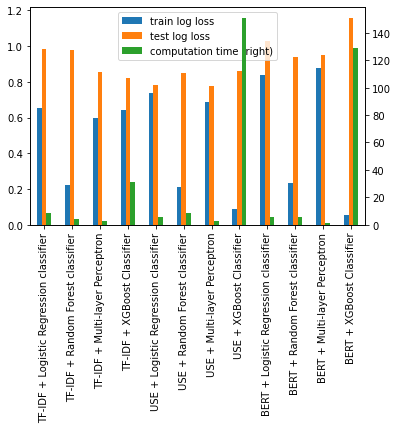

Evidence


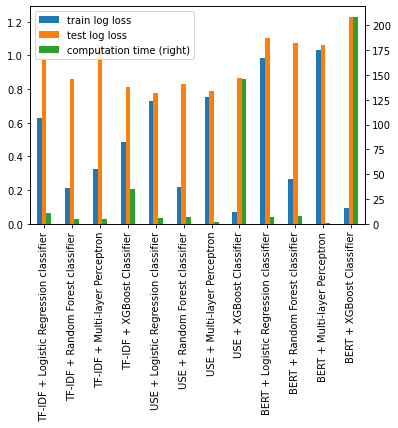

Rebuttal


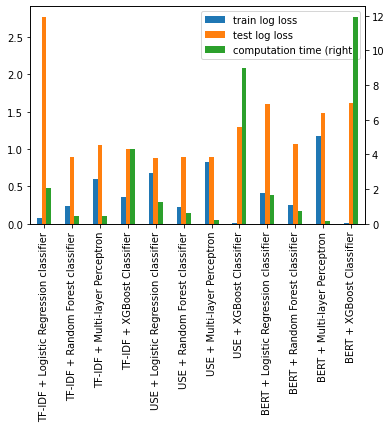

Position


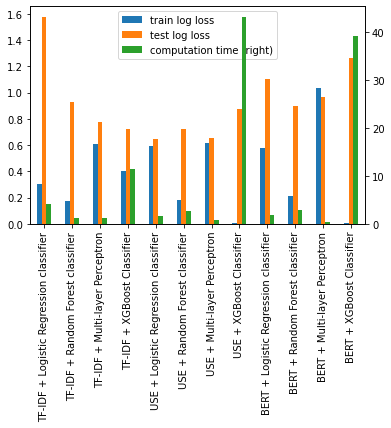

Concluding Statement


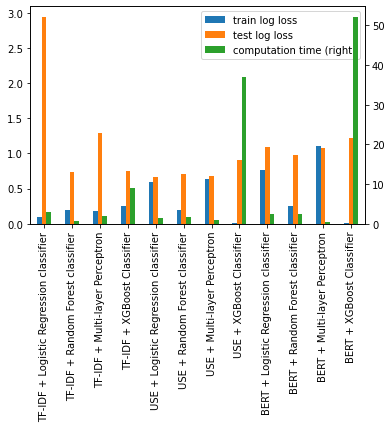

Lead


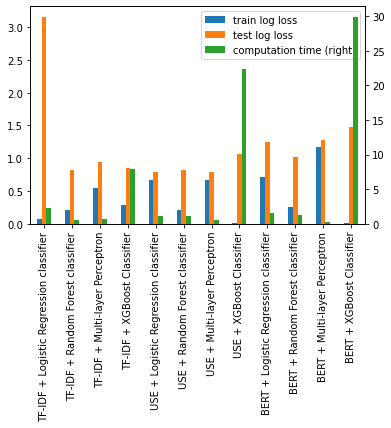

Counterclaim


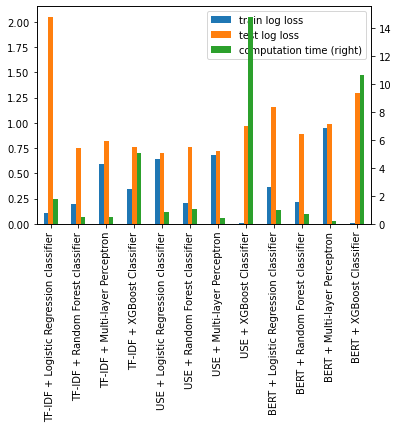

In [64]:
perfs = pd.DataFrame(columns = discourse_types)
for i in types:
    print(i)
    data_train_temp = data_train[data_train['discourse_type'] == i]
    data_test_temp = data_test[data_test['discourse_type'] == i]
    temp = compare_classifiers(data_train_temp, data_test_temp, 'discourse_effectiveness', list_vector, dict_classifiers)
    plot_performances(temp)
    perfs[i] = temp.loc['test log loss']

<AxesSubplot:>

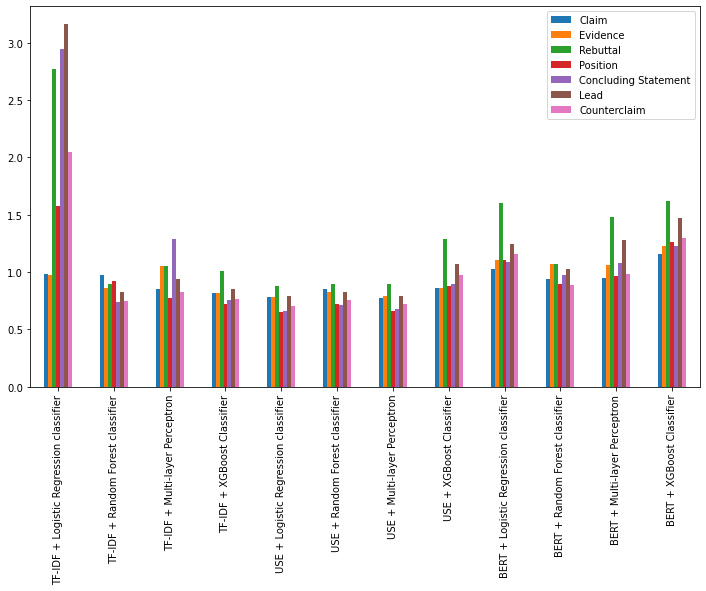

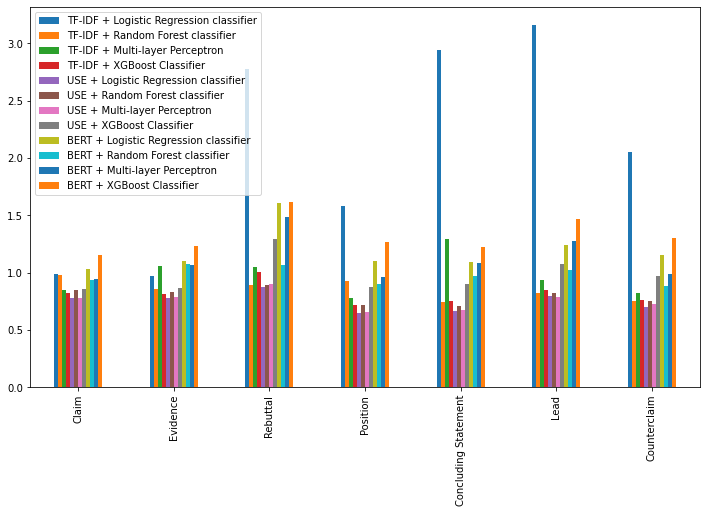

In [65]:
perfs.plot(kind='bar', figsize=(12,7))
perfs.transpose().plot(kind='bar', figsize=(12,7))

In [66]:
for i in discourse_types:
    print(i, " :")
    print(perfs[i].sort_values().iloc[:1])
    print("\n")

Claim  :
USE + Multi-layer Perceptron    0.776679
Name: Claim, dtype: float64


Evidence  :
USE + Logistic Regression classifier    0.778622
Name: Evidence, dtype: float64


Rebuttal  :
USE + Logistic Regression classifier    0.876759
Name: Rebuttal, dtype: float64


Position  :
USE + Logistic Regression classifier    0.65023
Name: Position, dtype: float64


Concluding Statement  :
USE + Logistic Regression classifier    0.662639
Name: Concluding Statement, dtype: float64


Lead  :
USE + Multi-layer Perceptron    0.79131
Name: Lead, dtype: float64


Counterclaim  :
USE + Logistic Regression classifier    0.700339
Name: Counterclaim, dtype: float64




# Optimisation

In [67]:
#Grid Search CV parameters

parameters_mlp = {
    'hidden_layer_sizes' : [(50,50,50), (50,100,50), (100,)],
    'activation' : ['logistic', 'relu'],
    'solver': ['adam'],
    'alpha' : [0.0001, 0.05],
    'random_state' : [42],
    'early_stopping' : [True],
    'validation_fraction' : [0.1],
}

parameters_lr = {
    'penalty' : ['l2'],
    'class_weight' : [None, 'balanced'],
    'random_state' : [42],
    'solver' : ['saga', 'lbfgs'],
    'multi_class' : ['auto'],
    'n_jobs' : [-1],
}

parameters_rf = {
    'n_estimators' : [50, 100, 200],
    'max_features' : ["sqrt", "log2"],
    'n_jobs' : [-1],
    'random_state' : [42],
    'class_weight' : [None, 'balanced'],
}

In [70]:
from sklearn.model_selection import GridSearchCV

def select_data(data_train, data_test, col_y, vect):
    X_train = pd.DataFrame(data_train[vect].dropna().tolist())
    X_test = pd.DataFrame(data_test[vect].dropna().tolist())
    LE = LabelEncoder()
    y_train = LE.fit_transform(data_train[col_y].iloc[X_train.index])
    y_test = LE.transform(data_test[col_y].iloc[X_test.index])
    return (X_train, y_train, X_test, y_test)

def cross_validation(X_train, y_train, classif, params):
    cross_val = GridSearchCV(classif(), params, scoring='neg_log_loss', n_jobs=-1)
    cross_val.fit(X_train, y_train)
    return cross_val.best_params_

def optimal_model(X_train, y_train, X_test, y_test, classif, params):
    model = classif(**params)
    model.fit(X_train, y_train)
    perform = indic_performances(model, X_train, y_train, X_test, y_test)
    return (model, perform)

In [71]:
(X_train, y_train, X_test, y_test) = select_data(data_train, data_test, 'discourse_effectiveness', 'USE')

start_time = timeit.default_timer()
best_params = cross_validation(X_train, y_train, MLPClassifier, parameters_mlp)
elapsed = timeit.default_timer() - start_time

print("Temps écoulé : {} s".format(elapsed))

Temps écoulé : 365.78038860000015 s


In [72]:
start_time = timeit.default_timer()
(model, scores) = optimal_model(X_train, y_train, X_test, y_test, MLPClassifier, best_params)
elapsed = timeit.default_timer() - start_time

print("log loss : {} sur le train et {} sur le test".format(scores[0], scores[1]))
print("Temps écoulé : {} s".format(elapsed))

log loss : 0.6959055469633927 sur le train et 0.77494659764372 sur le test
Temps écoulé : 51.99424680000084 s


## Split types

In [104]:
dict_best_combinations = {
    'Lead' : ('USE', RandomForestClassifier, parameters_rf),
    'Counterclaim' : ('BERT', RandomForestClassifier, parameters_rf),
    'Position' : ('USE', LogisticRegression, parameters_lr),
    'Concluding Statement' : ('USE', MLPClassifier, parameters_mlp),
    'Evidence' : ('USE', MLPClassifier, parameters_mlp),
    'Claim' : ('USE', MLPClassifier, parameters_mlp),
    'Rebuttal' : ('BERT', MLPClassifier, parameters_mlp),
}

In [105]:
models = {}
scores = {}

for i in discourse_types:
    data_train_temp = data_train[data_train['discourse_type'] == i]
    data_test_temp = data_test[data_test['discourse_type'] == i]
    (X_train, y_train, X_test, y_test) = select_data(data_train_temp, data_test_temp,
                                                     'discourse_effectiveness', dict_best_combinations[i][0])
    best_params = cross_validation(X_train, y_train, dict_best_combinations[i][1], dict_best_combinations[i][2])
    (models[i], scores[i]) = optimal_model(X_train, y_train, X_test, y_test,
                                    dict_best_combinations[i][1], best_params)
    print("log loss pour les documents du type " + i + " : {} sur le train et {} sur le test"
          .format(scores[i][0], scores[i][1]))

log loss pour les documents du type Claim : 0.7121601587023794 sur le train et 0.7732077187475493 sur le test
log loss pour les documents du type Evidence : 0.6726212688668919 sur le train et 0.7634028422091124 sur le test
log loss pour les documents du type Rebuttal : 0.9742350590076735 sur le train et 1.0600619093989425 sur le test
log loss pour les documents du type Position : 0.5899955219976327 sur le train et 0.6502295354802746 sur le test
log loss pour les documents du type Concluding Statement : 0.631110050943734 sur le train et 0.6649455905850253 sur le test
log loss pour les documents du type Lead : 0.2101953114927226 sur le train et 0.8122260317828272 sur le test
log loss pour les documents du type Counterclaim : 0.2117103165022156 sur le train et 0.8663340608193936 sur le test


# Modèle final

On compare le meilleur choix sur chaque type : soit le modèle global entraîné sur tout le corpus soit le modèle spécifique qui n'a étudié que ce type de texte.

In [106]:
def compare(X_test, y_test, global_model, specific_score):
    y_pred = global_model.predict_proba(X_test)
    log_loss_test = metrics.log_loss(y_test, y_pred)
    print("Test log loss: Global {:.2f}, Specific {:.2f}".format(log_loss_test, specific_score))
    Global_better = log_loss_test < specific_score
    if Global_better:
        print("Global model is better.")
    return Global_better

In [107]:
dict_best_combinations['Global'] = ('USE', model)
dict_final_models = {}
list_types_global_better = []
list_types_specific_better = []

for i in discourse_types:
    data_train_temp = data_train[data_train['discourse_type'] == i]
    data_test_temp = data_test[data_test['discourse_type'] == i]
    (X_train, y_train, X_test, y_test) = select_data(data_train_temp, data_test_temp,
                                                     'discourse_effectiveness', dict_best_combinations['Global'][0])
    print(i)
    Global_better = compare(X_test, y_test, model, scores[i][1])
    if Global_better:
        list_types_global_better.append(i)
        dict_final_models[i] = dict_best_combinations['Global']
    else:
        list_types_specific_better.append(i)
        dict_final_models[i] = (dict_best_combinations[i][0], models[i])
    dict_best_combinations[i] = (dict_best_combinations[i][0], models[i])
print("Global model is better for:")
print(list_types_global_better)

Claim
Test log loss: Global 0.78, Specific 0.77
Evidence
Test log loss: Global 0.81, Specific 0.76
Rebuttal
Test log loss: Global 0.85, Specific 1.06
Global model is better.
Position
Test log loss: Global 0.67, Specific 0.65
Concluding Statement
Test log loss: Global 0.73, Specific 0.66
Lead
Test log loss: Global 0.82, Specific 0.81
Counterclaim
Test log loss: Global 0.72, Specific 0.87
Global model is better.
Global model is better for:
['Rebuttal', 'Counterclaim']


In [108]:
def final_model_predict_proba(X, col_type, dict_models):
    vect = dict_models[X[col_type]][0]
    return dict_models[X[col_type]][1].predict_proba([X[vect]])[0]

y_pred = data_test.apply(lambda X : final_model_predict_proba(X, 'discourse_type', dict_final_models), axis=1)

LE = LabelEncoder()
y_train = LE.fit_transform(data_train['discourse_effectiveness'])
y_test = LE.transform(data_test['discourse_effectiveness'])

scoring = metrics.log_loss(y_test, np.array(y_pred.tolist()))

print("log loss sur le jeu de test pour le modèle mixte : {}".format(scoring))

log loss sur le jeu de test pour le modèle mixte : 0.7487902092211244


In [110]:
for key, item in dict_best_combinations.items():
    print(key, " : ", item[0], " + ", item[1])

Lead  :  USE  +  RandomForestClassifier(class_weight='balanced', max_features='sqrt',
                       n_estimators=200, n_jobs=-1, random_state=42)
Counterclaim  :  BERT  +  RandomForestClassifier(class_weight='balanced', max_features='log2',
                       n_estimators=200, n_jobs=-1, random_state=42)
Position  :  USE  +  LogisticRegression(n_jobs=-1, random_state=42)
Concluding Statement  :  USE  +  MLPClassifier(alpha=0.05, early_stopping=True, hidden_layer_sizes=(50, 100, 50),
              random_state=42)
Evidence  :  USE  +  MLPClassifier(alpha=0.05, early_stopping=True, random_state=42)
Claim  :  USE  +  MLPClassifier(alpha=0.05, early_stopping=True, random_state=42)
Rebuttal  :  BERT  +  MLPClassifier(activation='logistic', early_stopping=True, random_state=42)
Global  :  USE  +  MLPClassifier(alpha=0.05, early_stopping=True, random_state=42)


Le modèle final est donc l'aggrégation des modèles suivants :
- USE + Random Forest pour les Lead
- USE + Régression Logistique pour les Position
- USE + MLP pour les Concluding Statement
- USE + MLP pour les Evidence
- USE + MLP pour les Claim
- USE + MLP entraîné sur TOUT le dataset pour les Rebuttal et Counterclaim

Ce modèle mixte est légèrement meilleur que le modèle global (USE + MLP entraîné sur TOUT le dataset), puisqu'il totalise une log loss de $0.75$ tandis que le modèle global atteint $0.77$.